Sources: https://colab.research.google.com/drive/1_kbRZPTjnFgViPrmGcUsaszEdYa8XTpq?usp=sharing#scrollTo=gVJOhMKfFc2u,
https://thepythoncode.com/article/generate-images-from-text-stable-diffusion-python,
https://colab.research.google.com/github/huggingface/notebooks/blob/main/diffusers/stable_diffusion.ipynb

In [ ]:
%pip install --upgrade diffusers transformers torch

In [ ]:
import torch
import numpy as np
import diffusers
import transformers
from diffusers import LMSDiscreteScheduler
from diffusers.schedulers.scheduling_ddim import DDIMScheduler

from tqdm.auto import tqdm
from PIL import Image
from IPython.display import Image as DisplayImage
from IPython.display import display
import io

from huggingface_hub import notebook_login
from google.colab import output

output.enable_custom_widget_manager()
notebook_login()

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
class DiffusionModel():

  def __init__(self, vae, tokenizer, text_encoder, unet, scheduler_LMS, scheduler_DDIM):
    #variational auoencoder, converts image into latent representation
    self.vae = vae
    #text to numerical tokens
    self.tokenizer = tokenizer
    #neural network, for tokens into vectors
    self.text_encoder = text_encoder
    # neural network, backward diffusion
    self.unet = unet
    #Laplacian Multi-Step, for controlling backward diffusion
    self.scheduler_LMS = scheduler_LMS
    #Denoising Diffusion Implicit Models, for controlling backward diffusion but better,
    #will use for generating similar images
    self.scheduler_DDIM = scheduler_DDIM
    self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")




  def get_text_embeds(self, text):
    #tokenizing
    text_input = self.tokenizer(text, padding="max_length", max_length=self.tokenizer.model_max_length,
                                truncation=True, return_tensors="pt")
    #embedding (vectors capturing semantic meaning)
    with torch.no_grad():
      text_embeddings = self.text_encoder(text_input.input_ids.to(self.device))[0]
    return text_embeddings



  def get_prompt_embeds(self, text):
    #conditional
    cond_text_embeddings = self.get_text_embeds(text)
    #unconditional
    uncond_text_embeddings = self.get_text_embeds(['']*len(text))
    text_embeddings = torch.cat([uncond_text_embeddings, cond_text_embeddings])

    return text_embeddings




  def get_latents(self, text_embeddings, scheduler, hight=512, width=512,
                  num_inference_steps=50, guidance_scale=7.5, latents=None, return_all=False,
                  start_step = 10):
    initial_step = 0
    #generate noise if there were no starting latents
    if latents is None:
      latents = torch.randn(
          (text_embeddings.shape[0] // 2, self.unet.config.in_channels, hight // 8, width // 8),
          device=self.device)
      latents = latents.to(self.device)
    else:
      initial_step = start_step

    #set number of steps for scheduler
    scheduler.set_timesteps(num_inference_steps)

    if initial_step > 0:
      num_inference_steps = num_inference_steps + initial_step
      #how far in generation it will start
      start_timestep = scheduler.timesteps[initial_step]
      #for more then one image
      start_timesteps = start_timestep * torch.ones([latents.shape[0]]).long()
      #generate noise simillar to latents
      noise = torch.randn_like(latents)
      #adding noise to the latents tensor on start timestep
      latents = scheduler.add_noise(latents, noise, start_timesteps)
    else:
      #scaling initial latents
      latents = latents * scheduler.sigmas[0]

    #for making a gif
    past_latents = [latents]

    with torch.autocast("cuda"):
      for i, t in tqdm(enumerate(scheduler.timesteps[initial_step:])):
        print(f"Iteration:{i} out of {num_inference_steps}...")
        #single forward pass
        latent_model_input = torch.cat([latents] * 2)

        if initial_step == 0:
           #current noise level
          sigma = scheduler.sigmas[i]
          #scaling latents for Unet
          latent_model_input = latent_model_input / ((sigma**2 + 1) ** 0.5)

        with torch.no_grad():
          #predicting noise with Unet at current timestep
          noise_pred = self.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
        #guidance
        noise_pred_uncond, noise_pred_cond = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_cond - noise_pred_uncond)
        #denoising the latents
        if i < len(scheduler.timesteps) - 1:
          latents = scheduler.step(noise_pred, t, latents).prev_sample
        past_latents.append(latents)

    if return_all:
      return torch.cat(past_latents, dim=0)
    return latents




  def decode_latents(self, latents):
    #constant
    latents = latents / 0.18215

    with torch.no_grad():
      #decoding latents into image with VAE
      images = self.vae.decode(latents)

    #range transformation from [-1, 1] to [0, 1]
    images = (images.sample / 2 + 0.5).clamp(0, 1)
    #channel rearrangement
    images = images.detach().cpu().permute(0, 2, 3, 1).numpy()
    #scaling
    images = (images * 255).round().astype("uint8")
    images = [Image.fromarray(image) for image in images]
    return images




  def generate(self, text, height=512, width=512, num_inference_steps=50, guidance_scale=7.5,
               latents=None, return_all=False, batch_size=2, start_step=10):
    if latents is not None:
      scheduler = self.scheduler_DDIM
    else:
      scheduler = self.scheduler_LMS
    #text to list
    if isinstance(text, str):
      text = [text]
    #getting embeddings for guidance
    text_embeddings = self.get_prompt_embeds(text)
    #generation!
    latents = self.get_latents(text_embeddings, scheduler, height, width, num_inference_steps,
                               guidance_scale, latents, return_all, start_step)
    #for single image
    if not return_all:
      images = self.decode_latents(latents)
      return images
    #foer gif
    all_images = []
    for i in tqdm(range(0, len(latents), batch_size)):
      images = self.decode_latents(latents[i:i+batch_size])
      all_images.extend(images)
    return all_images




  def generate_gif(self, text, height=512, width=512, num_inference_steps=50, guidance_scale=7.5,
                   latents=None, batch_size=2, duration=100, hold_on_last_frame=True, hold_duration=1000, start_step=10):
    images = self.generate(text, height, width, num_inference_steps, guidance_scale,
                           latents, return_all=True, batch_size=batch_size, start_step=start_step)

    if hold_on_last_frame:
      num_extra_frames = hold_duration // duration
      images.extend([images[-1]] * num_extra_frames)

    gif = io.BytesIO()

    images[0].save(gif, format='GIF', save_all=True, append_images=images[1:], duration=duration, loop=0)

    gif.seek(0)

    return gif




  def encode_images(self, images):
    if not isinstance(images, list):
      images = [images]

    images_arr = np.stack([np.array(image) for image in images], axis=0)
    images_arr = images_arr / 255.0
    images_arr = torch.from_numpy(images_arr).float().permute(0, 3, 1, 2)
    images_arr = images_arr * 2 - 1
    latent_dists = self.vae.encode(images_arr.to(device))
    latents = latent_dists.latent_dist.sample()
    latents = latents * 0.18215
    return latents


In [ ]:
device = 'cuda'

vae = diffusers.AutoencoderKL.from_pretrained('CompVis/stable-diffusion-v1-4', subfolder='vae').to(device)

tokenizer = transformers.CLIPTokenizer.from_pretrained('openai/clip-vit-large-patch14')
text_encoder = transformers.CLIPTextModel.from_pretrained('openai/clip-vit-large-patch14').to(device)

unet = diffusers.UNet2DConditionModel.from_pretrained('CompVis/stable-diffusion-v1-4', subfolder='unet',
                                                      use_auth_token=True).to(device)

scheduler_LMS = LMSDiscreteScheduler(beta_start=0.00085,
                                 beta_end=0.012,
                                 beta_schedule='scaled_linear',
                                 num_train_timesteps=1000)

scheduler_DDIM = DDIMScheduler(beta_start=0.00085,
                               beta_end=0.012,
                               beta_schedule='scaled_linear',
                               num_train_timesteps=1000)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [ ]:
model = DiffusionModel(vae, tokenizer, text_encoder, unet, scheduler_LMS, scheduler_DDIM)

prompts = ["Anime style aesthetic landscape, 90's vintage style, digital art, ultra HD, 8k, photoshopped, sharp focus, surrealism, detailed line art"]

images = model.generate(prompts)

0it [00:00, ?it/s]

0


/usr/local/lib/python3.11/dist-packages/diffusers/schedulers/scheduling_lms_discrete.py:468: UserWarning: The `scale_model_input` function should be called before `step` to ensure correct denoising. See `StableDiffusionPipeline` for a usage example.
  warnings.warn(


1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


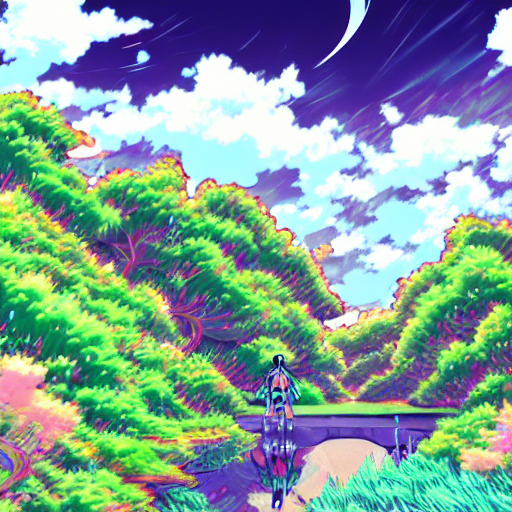

In [ ]:
images[0]

Creating a GIF

In [ ]:
gif = model.generate_gif("pint of beer", num_inference_steps=100, hold_on_last_frame=True,
                         hold_duration=3000)

0it [00:00, ?it/s]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99


  0%|          | 0/51 [00:00<?, ?it/s]

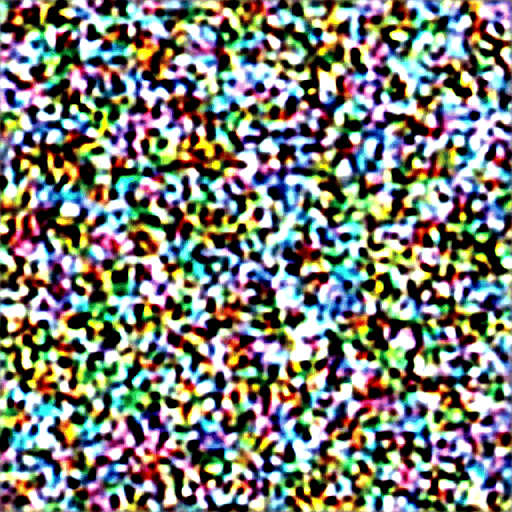

In [ ]:
display(DisplayImage(data=gif.getvalue()))

In [ ]:
"""from google.colab import drive

drive.mount('/content/drive')

with open('/content/drive/My Drive/beer.gif', 'wb') as f:
  f.write(gif.getvalue())"""

Image to image

0it [00:00, ?it/s]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99


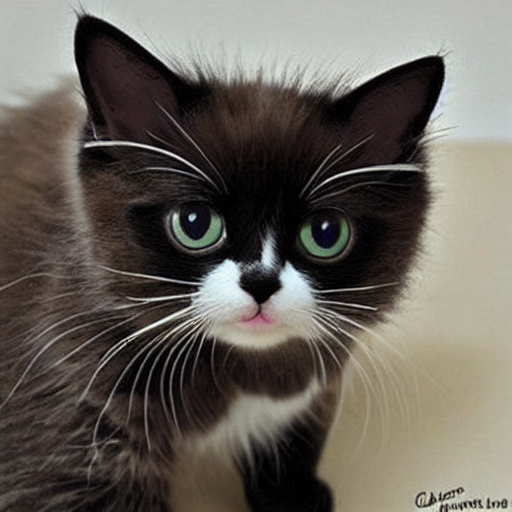

In [ ]:
#latents = torch.randn((1, unet.in_channels, 512 // 8, 512 // 8), device=device)
image = model.generate("cute cat", num_inference_steps=100, batch_size=1)[0]
image

In [ ]:
latents = model.encode_images(image)
test = model.generate("cat", num_inference_steps=100, batch_size=1, latents=latents, start_step=35)[0]

0it [00:00, ?it/s]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64


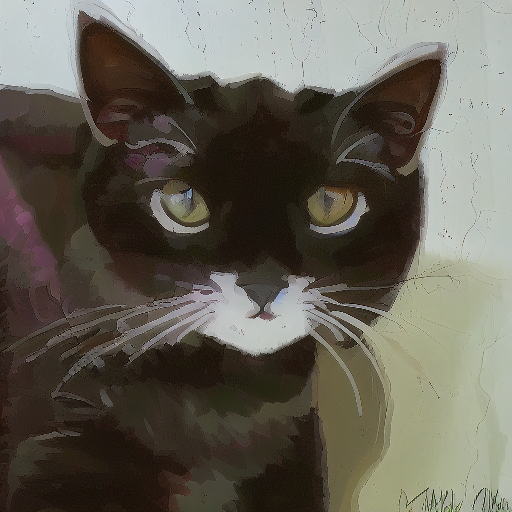

In [ ]:
test

In [ ]:
img1 = Image.open('/content/img1.png').convert('RGB')
img1 = img1.resize((512, 512))

img2 = Image.open('/content/img2.png').convert('RGB')
img2 = img2.resize((512, 512))

In [ ]:
img1_latents = model.encode_images(img2)
generated_img1 = model.generate("human", num_inference_steps=100, batch_size=1, latents=img1_latents, start_step=30)[0]

0it [00:00, ?it/s]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69


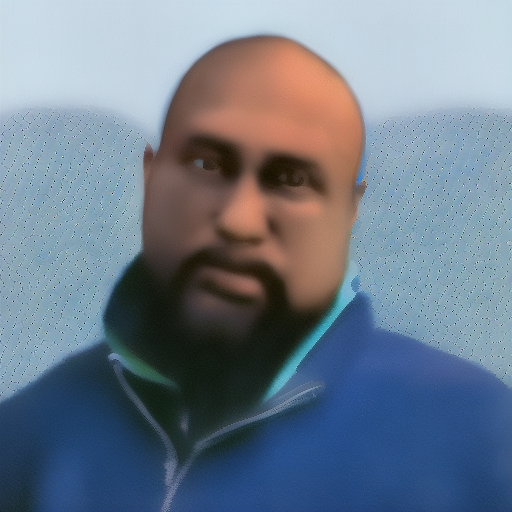

In [ ]:
generated_img1

In [ ]:
#img2_latents = model.encode_images(img2)
#generated_img2_gif = model.generate_gif("human", num_inference_steps=100, batch_size=1, latents=img2_latents, hold_on_last_frame=True,
#                         hold_duration=3000, start_step=40)

0it [00:00, ?it/s]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59


  0%|          | 0/61 [00:00<?, ?it/s]